# Annotations using clustering for cells for colon_s1

In [1]:
slide_id = "colon_s1"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_{slide_id}.zarr")
sdata

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/spatialdata/_core/spatialdata.py:158: UserWarning: The table is annotating 'cell_labels', which is not present in the SpatialData object.
  self.validate_table_in_spatialdata(v)


SpatialData object, with associated Zarr store: /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_colon_s1.zarr
├── Images
│     └── 'he': DataTree[cyx] (3, 43090, 26909), (3, 21545, 13455)
├── Points
│     └── 'st': DataFrame with shape: (<Delayed>, 10) (3D points)
├── Shapes
│     ├── 'cell_boundaries': GeoDataFrame shape: (587115, 1) (2D shapes)
│     └── 'nucleus_boundaries': GeoDataFrame shape: (587115, 1) (2D shapes)
└── Tables
      ├── 'table_cells': AnnData (587115, 425)
      └── 'table_nuclei': AnnData (587115, 541)
with coordinate systems:
    ▸ '_st_intrinsic', with elements:
        st (Points)
    ▸ 'global', with elements:
        he (Images), st (Points), cell_boundaries (Shapes), nucleus_boundaries (Shapes)

In [4]:
adata_cells_ini = sdata.tables['table_cells'].copy()
adata_cells_ini

AnnData object with n_obs × n_vars = 587115 × 425
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

In [5]:
adata_cells_ini.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region
0,aaaaaaaa-1,25,0,0,0,0,25,33.054376,11.966407,cell_labels
1,aaaaaaab-1,60,0,0,0,0,60,92.976722,20.907345,cell_labels
2,aaaaaaac-1,17,0,0,0,0,17,178.186569,7.766875,cell_labels
3,aaaaaaad-1,33,0,0,0,0,33,84.984066,16.888438,cell_labels
4,aaaaaaae-1,18,0,0,0,0,18,43.485470,18.378594,cell_labels
...,...,...,...,...,...,...,...,...,...,...
587110,aaaipfgg-1,209,0,0,0,0,209,78.120315,64.979846,cell_labels
587111,aaaipfgh-1,109,0,0,0,0,109,56.625940,38.563439,cell_labels
587112,aaaipfgi-1,127,0,0,0,0,127,53.239221,30.074064,cell_labels
587113,aaaipfgj-1,298,0,0,0,0,298,105.710785,74.417503,cell_labels


In [6]:
adata_cells_ini.var

,gene_ids,feature_types,genome
ABCA8,ENSG00000141338,Gene Expression,Unknown
ABCC8,ENSG00000006071,Gene Expression,Unknown
ACACB,ENSG00000076555,Gene Expression,Unknown
ACKR1,ENSG00000213088,Gene Expression,Unknown
ACTA2,ENSG00000107796,Gene Expression,Unknown
...,...,...,...
VWF,ENSG00000110799,Gene Expression,Unknown
WFDC2,ENSG00000101443,Gene Expression,Unknown
WNT5B,ENSG00000111186,Gene Expression,Unknown
XCL2,ENSG00000143185,Gene Expression,Unknown


In [7]:
adata_nuclei = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
adata_nuclei

AnnData object with n_obs × n_vars = 515303 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6', 'pca_n10_pcs16_leiden_res0.9', 'refine_res', 'label1', 'label2', 'label3'
    var: 'mean', 'std'
    uns: 'ct_tangram_colors', 'label1_colors', 'label2_colors', 'label3_colors', 'log1p', 'pca', 'pca_n10_pcs16', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.2_colors', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.4_colors', 'pca_n10_pcs16_leiden_res0.6', 'pca_n10_pcs16_leiden_res0.6_colors', 'pca_n10_pcs16_leiden_res0.9', 'pca_n10_pcs16_leiden_res0.9_colors', 'rank_genes_pca_n10_pcs16_leiden_res0.2', 'rank_genes_pca_n10_pcs16_leiden_res0.4', 'rank_genes_refine_res', 'refine_res_colors', 'sopa_attrs', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'tangram_pred'
    varm: 'PCs'
    layers: 'count', 'log_norm'
    obsp: 'pc

In [8]:
adata_nuclei.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,pca_n10_pcs16_leiden_res0.9,refine_res,label1,label2,label3
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,10.656944,NK cell,12,1,3,2,1,3,T,T,normal_cell
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,19.123695,Treg cell,15,1,3,2,1,3,T,T,normal_cell
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,15.420862,Mast cell,14,1,3,5,16,3,T,T,normal_cell
aaaaaaaf-1,nucleus_boundaries,morpho,aaaaaaaf-1,29.870687,cDC1,17,1,4,4,3,4,Macrophage,Macrophage,normal_cell
aaaaaaag-1,nucleus_boundaries,morpho,aaaaaaag-1,23.977778,Tuft cell,18,1,3,5,1,3,T,T,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaaipfgg-1,nucleus_boundaries,morpho,aaaipfgg-1,61.502159,ACTG2+ contractile pericyte,164,0,9,3,2,9,Epithelial,Colorectal_epithelial_cell,normal_cell
aaaipfgh-1,nucleus_boundaries,morpho,aaaipfgh-1,36.465073,CCL19/21 fibroblast,91,0,2,1,2,2,Epithelial,High_proliferative_epithelial_cell,cancer_cell
aaaipfgi-1,nucleus_boundaries,morpho,aaaipfgi-1,27.771561,Memory CD4 T cell,68,0,2,1,7,2,Epithelial,High_proliferative_epithelial_cell,cancer_cell
aaaipfgj-1,nucleus_boundaries,morpho,aaaipfgj-1,69.613848,Cycling ACTG2+ contractile pericyte,193,0,1,3,8,1,Epithelial,High_proliferative_epithelial_cell,cancer_cell


In [9]:
adata_nuclei.var

,mean,std
ABCA8,0.072379,0.612109
ABCC8,0.018722,0.307096
ACACB,0.440374,1.399277
ACKR1,0.050096,0.520476
ACTA2,0.741555,1.967228
...,...,...
VWF,0.233402,1.141686
WFDC2,0.035553,0.409782
WNT5B,0.063675,0.581822
XCL2,0.031998,0.409695


## 2. Preprocessing

<Axes: >

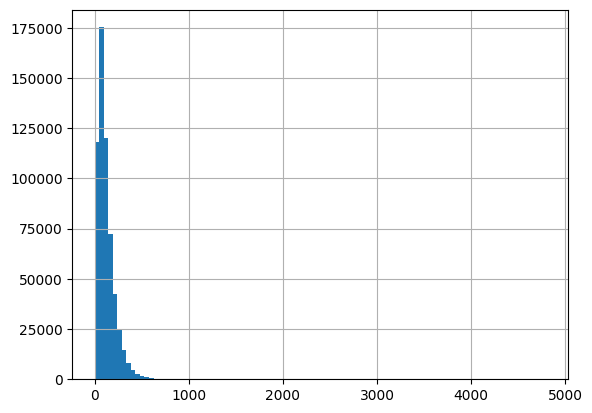

In [10]:
adata_cells_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

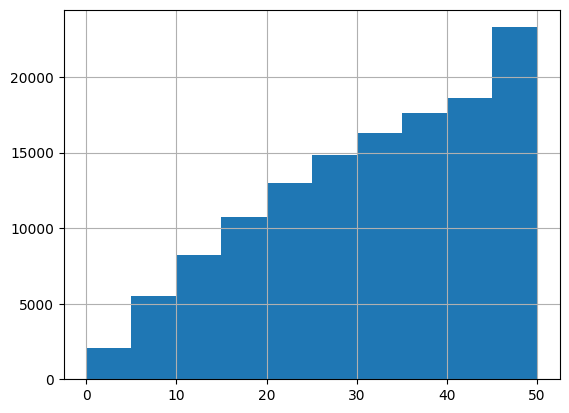

In [11]:
# in range 0-50
adata_cells_ini.obs['transcript_counts'].hist(range=(0,50))

In [12]:
print(f"Number of cells with less than 20 transcripts: {(adata_cells_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<20).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_cells_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<15).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_cells_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<10).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_cells_ini.obs)}")

Number of cells with less than 20 transcripts: 26521
Percentage of cells with less than 20 transcripts: 4.52%
-----
Number of cells with less than 15 transcripts: 15805
Percentage of cells with less than 15 transcripts: 2.69%
-----
Number of cells with less than 10 transcripts: 7598
Percentage of cells with less than 10 transcripts: 1.29%
-----
Number total of cells: 587115


In [13]:
adata_cells =  adata_cells_ini[adata_cells_ini.obs['transcript_counts']>10].copy()
print(len(adata_cells.obs))

578139


In [14]:
# Save the raw data
adata_cells.layers['count'] = adata_cells.X.copy()

In [15]:
# Normalize
sc.pp.normalize_total(adata_cells, target_sum=1e4)
sc.pp.log1p(adata_cells)
adata_cells.layers['log_norm'] = adata_cells.X.copy()

In [16]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata_cells, max_value=10)

## 3. Principal component analysis

In [17]:
# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(adata_cells, svd_solver="arpack", use_highly_variable=False)

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:385: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


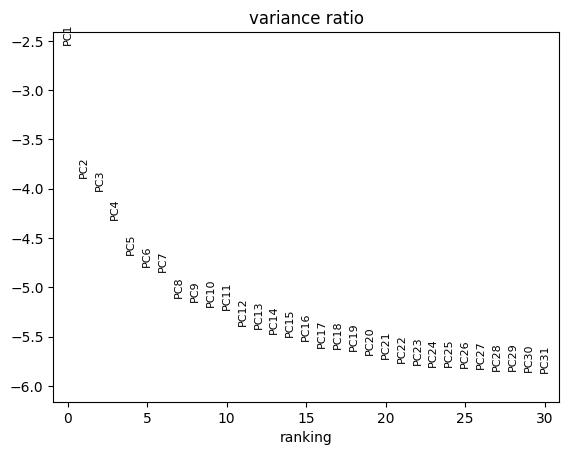

In [18]:
# Contribution of single PCs to the total variance in the data
# This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
sc.pl.pca_variance_ratio(adata_cells, log=True)

In [19]:
adata_cells

AnnData object with n_obs × n_vars = 578139 × 425
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome', 'mean', 'std'
    uns: 'spatialdata_attrs', 'log1p', 'pca'
    obsm: 'spatial', 'X_pca'
    varm: 'PCs'
    layers: 'count', 'log_norm'

In [20]:
# Restore X to be log norm counts
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
dc.swap_layer(adata_cells, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [21]:
# Neighborhood graph of cells using the PCA representation of the data matrix
sc.pp.neighbors(adata_cells, n_neighbors=10, n_pcs=16, use_rep="X_pca", key_added='pca_n10_pcs16')
# Embedding the neighborhood graph using UMAP
sc.tl.umap(adata_cells, neighbors_key='pca_n10_pcs16')
# Leiden clustering directly clusters the neighborhood graph of cells
sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.4', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.6', neighbors_key='pca_n10_pcs16')

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_4107/1436083260.py:6: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')


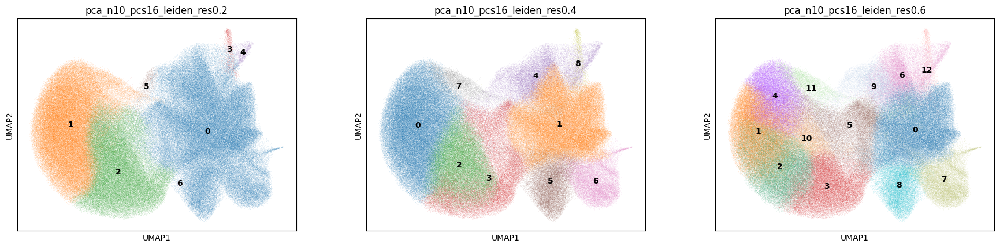

In [22]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16',
           color=['pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6'],
           ncols=3, legend_loc='on data')

In [23]:
# Number of clusters
adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].unique()

['9', '0', '8', '3', '12', ..., '11', '4', '1', '2', '10']
Length: 13
Categories (13, object): ['0', '1', '2', '3', ..., '9', '10', '11', '12']

In [24]:
# Refine resolution
adata_cells.obs['refine_res'] = 'att'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['0']), 'refine_res'] = '0'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['1']), 'refine_res'] = '1'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['2']), 'refine_res'] = '2'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['3']), 'refine_res'] = '3'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['4']), 'refine_res'] = '4'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['5']), 'refine_res'] = '5'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['6']), 'refine_res'] = '6'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['7']), 'refine_res'] = '7'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['8']), 'refine_res'] = '8'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['9']), 'refine_res'] = '9'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['10']), 'refine_res'] = '10'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['11']), 'refine_res'] = '11'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['12']), 'refine_res'] = '12'

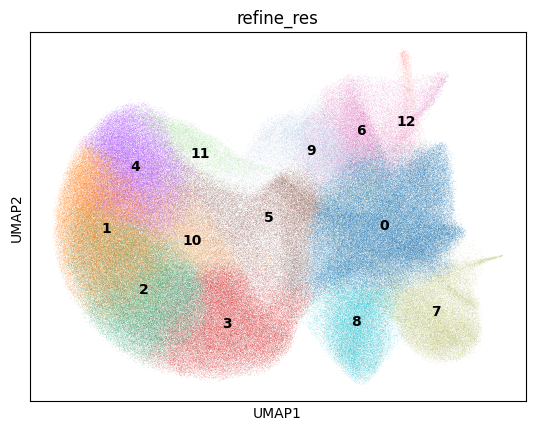

In [25]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [26]:
clustering_label = 'refine_res'

In [27]:
merged_df = pd.merge(adata_cells.obs[['cell_id', 'refine_res']].copy(), adata_nuclei.obs[['cell_id', 'label1', 'label2', 'label3']].copy(), on='cell_id', how='outer')

for col in ['label1', 'label2', 'label3']:
    if merged_df[col].dtype.name == 'category':  # Check if already categorical
        merged_df[col] = merged_df[col].cat.add_categories('NA')  # Add 'NA' as a category
merged_df[['label1', 'label2', 'label3']] = merged_df[['label1', 'label2', 'label3']].fillna('NA')

merged_df['label_combined'] = merged_df[['label1', 'label2', 'label3']].apply(lambda x: '&'.join(x.astype(str)), axis=1)

def compare_with_nuclei(merged_df, cluster_id):

    df_filtered = merged_df[merged_df['refine_res'] == cluster_id]
    label_counts = df_filtered['label_combined'].value_counts(normalize=True)
    top_5 = label_counts.head(5)

    top_5_df = top_5.reset_index()
    top_5_df.columns = ['label_combined', 'percentage']
    
    labels_split = top_5_df['label_combined'].str.split('&', expand=True)
    labels_split.columns = ['label1', 'label2', 'label3']

    top_5_df['percentage'] = (top_5_df['percentage'] * 100).round(1).astype(str)

    top_5_df_final = pd.concat([labels_split, top_5_df['percentage']], axis=1)
    
    return top_5_df_final

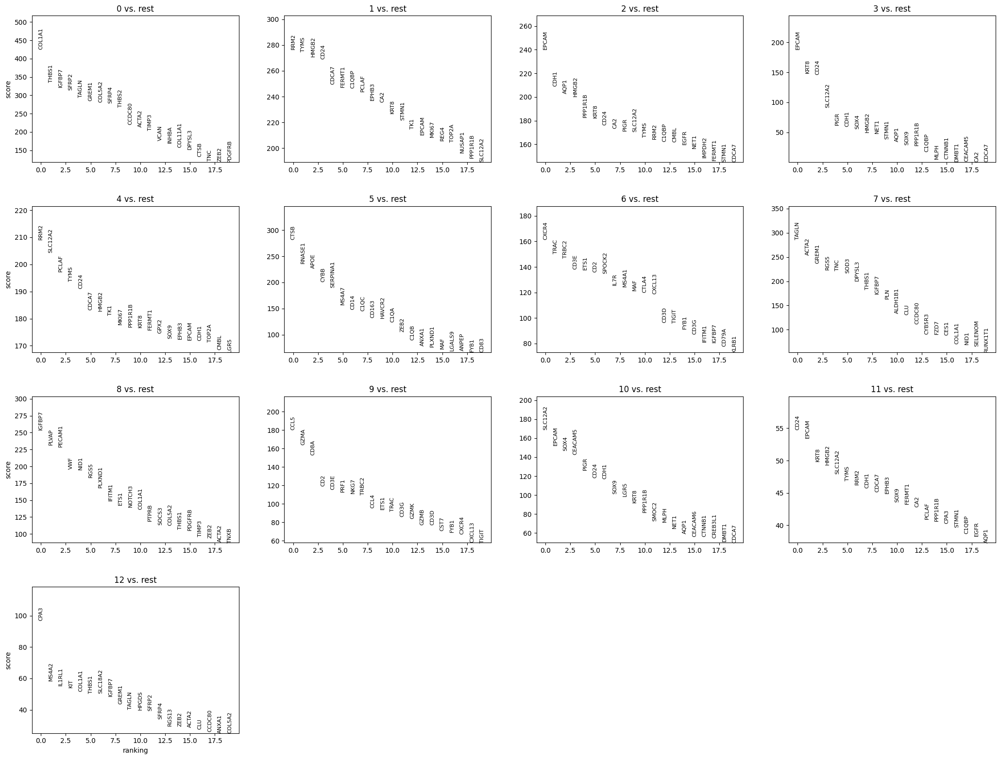

In [28]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata_cells, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata_cells, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [29]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata_cells.uns["rank_genes_"+clustering_label]["names"]).iloc[:7, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [30]:
adata_cells.obs['label1'] = 'att'
adata_cells.obs['label2'] = 'att'
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

### 5.1. Cluster 0

In [31]:
cluster_id = '0'

In [32]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Fibroblast,CAF,normal_cell,26.9
1,NA,NA,NA,22.5
2,B,B,normal_cell,18.4
3,T,T,normal_cell,12.9
4,Macrophage,Macrophage,normal_cell,12.4


In [33]:
top_ranked_genes[cluster_id]

0    COL1A1
1     THBS1
2    IGFBP7
3     SFRP2
4     TAGLN
5     GREM1
6    COL5A2
Name: 0, dtype: object

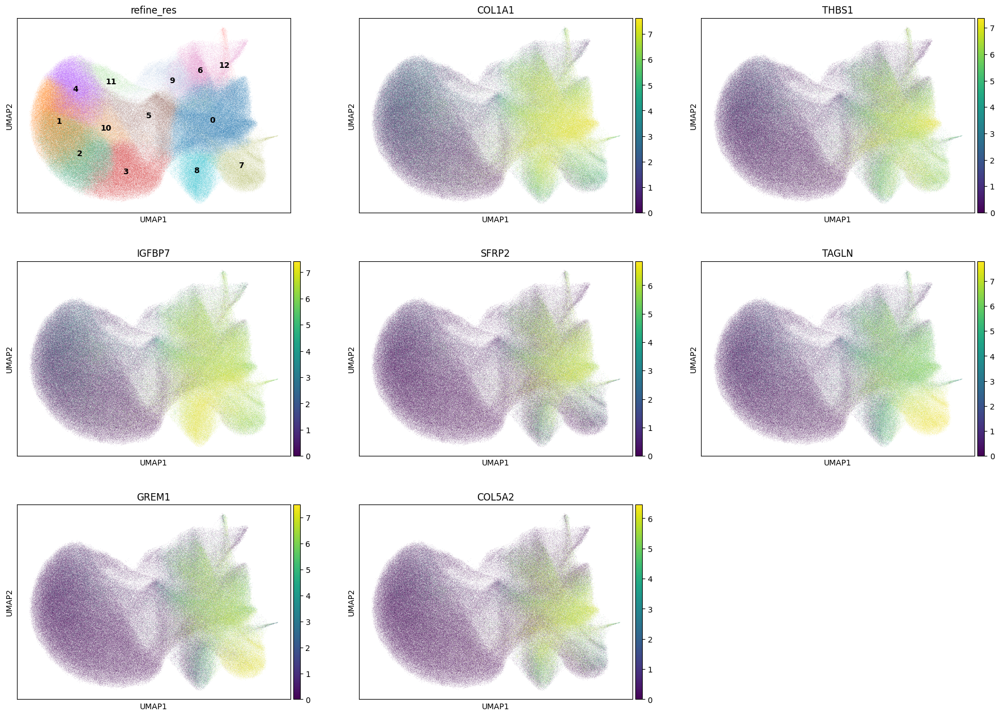

In [34]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [35]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 121305
Percentage of cells in cluster 0: 21.0


In [36]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'CAF'

### 5.2. Cluster 1

In [37]:
cluster_id = '1'

In [38]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,High_proliferative_epithelial_cell,cancer_cell,85.9
1,Epithelial,Colorectal_epithelial_cell,normal_cell,13.2
2,Pericyte,Pericyte,normal_cell,0.3
3,NA,NA,NA,0.2
4,T,T,normal_cell,0.1


In [39]:
top_ranked_genes[cluster_id]

0      RRM2
1      TYMS
2     HMGB2
3      CD24
4     CDCA7
5    FERMT1
6     C1QBP
Name: 1, dtype: object

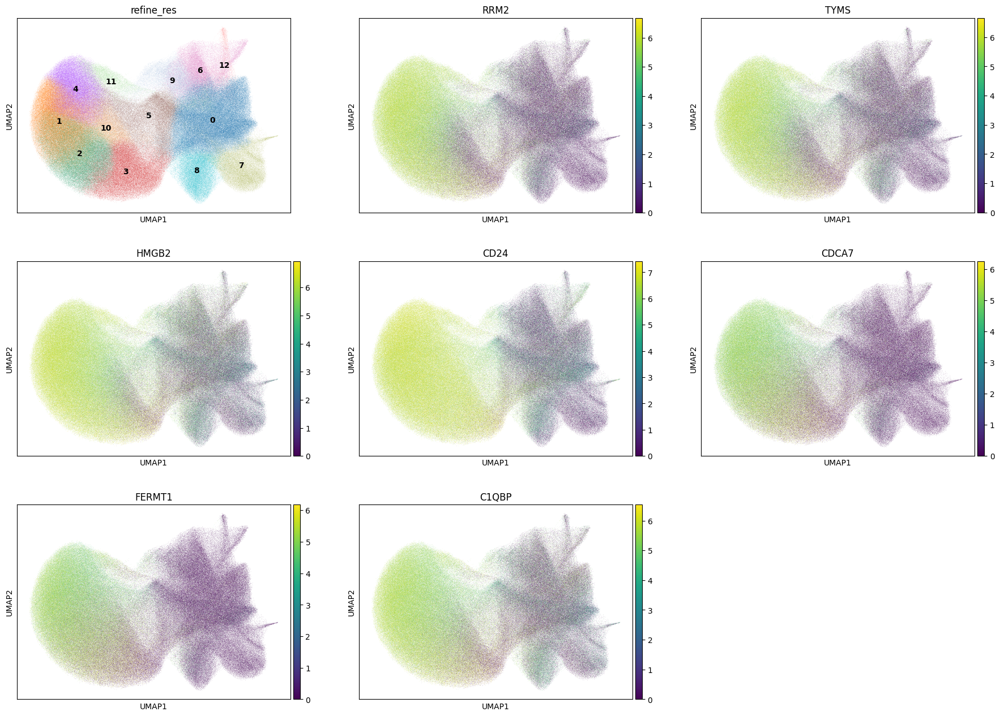

In [40]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [41]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 79586
Percentage of cells in cluster 1: 13.8


In [42]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Proliferating_colorectal_epithelial_cell'

### 5.3. Cluster 2

In [43]:
cluster_id = '2'

In [44]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Colorectal_epithelial_cell,normal_cell,49.6
1,Epithelial,High_proliferative_epithelial_cell,cancer_cell,49.1
2,NA,NA,NA,0.9
3,T,T,normal_cell,0.2
4,Macrophage,Macrophage,normal_cell,0.1


In [45]:
top_ranked_genes[cluster_id]

0      EPCAM
1       CDH1
2       AQP1
3      HMGB2
4    PPP1R1B
5       KRT8
6       CD24
Name: 2, dtype: object

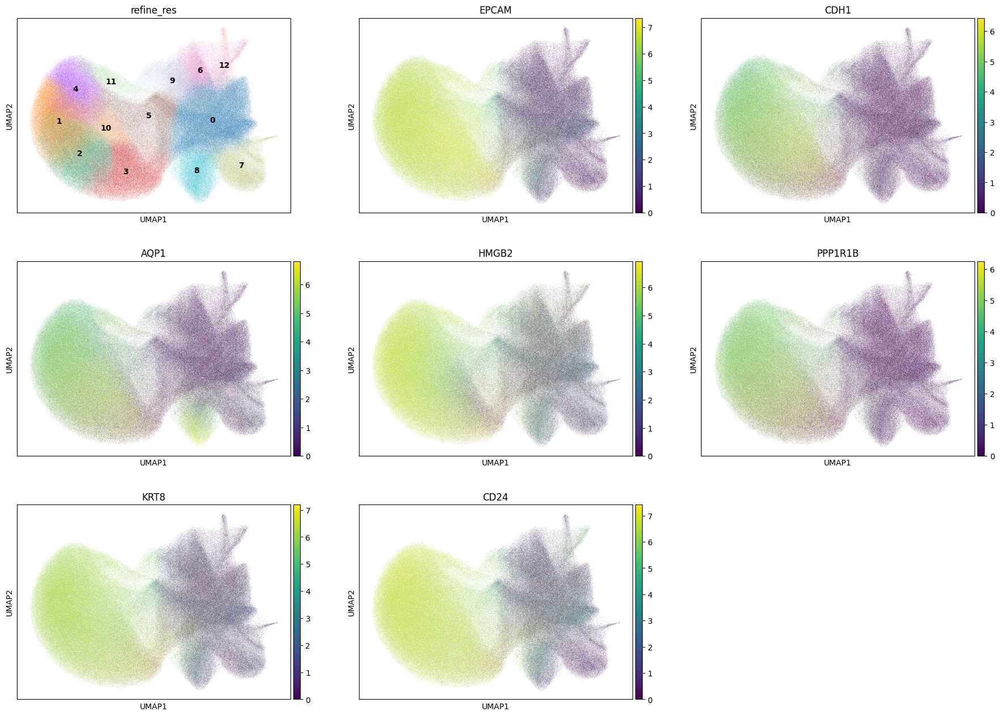

In [46]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [47]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 65082
Percentage of cells in cluster 2: 11.3


In [48]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Colorectal_epithelial_cell'

### 5.4. Cluster 3

In [49]:
cluster_id = '3'

In [50]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Colorectal_epithelial_cell,normal_cell,69.4
1,NA,NA,NA,24.1
2,Epithelial,High_proliferative_epithelial_cell,cancer_cell,3.1
3,Macrophage,Macrophage,normal_cell,1.2
4,T,T,normal_cell,1.1


In [51]:
top_ranked_genes[cluster_id]

0      EPCAM
1       KRT8
2       CD24
3    SLC12A2
4       PIGR
5       CDH1
6       SOX4
Name: 3, dtype: object

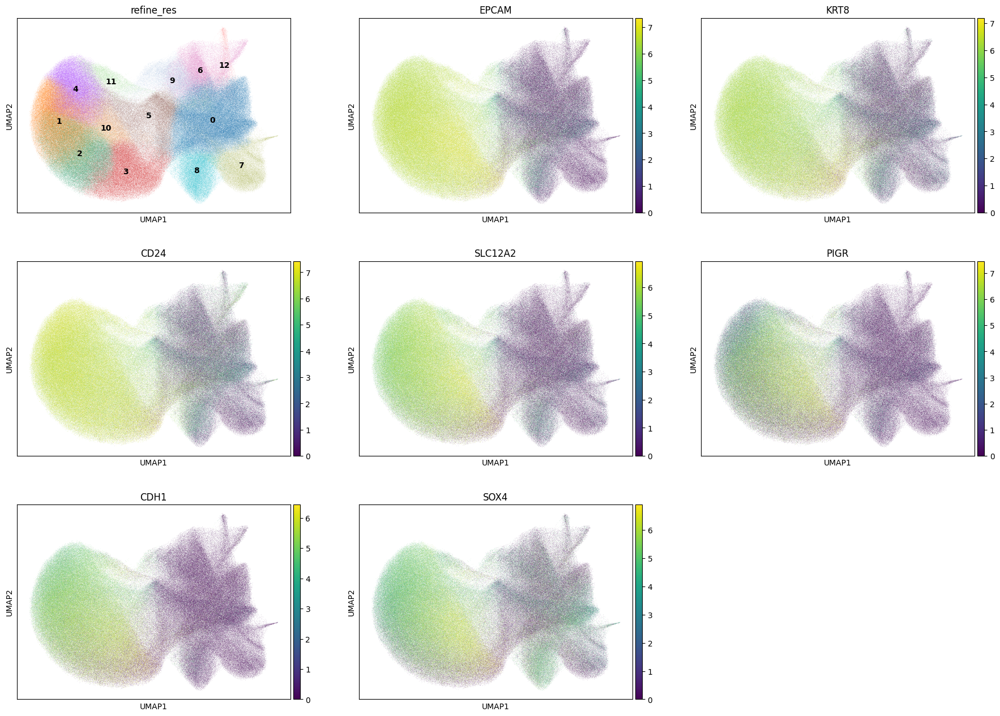

In [52]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [53]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 60030
Percentage of cells in cluster 3: 10.4


In [54]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Colorectal_epithelial_cell'

### 5.5. Cluster 4

In [55]:
cluster_id = '4'

In [56]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,High_proliferative_epithelial_cell,cancer_cell,91.6
1,Epithelial,Colorectal_epithelial_cell,normal_cell,8.3
2,T,T,normal_cell,0.1
3,NA,NA,NA,0.0
4,Macrophage,Macrophage,normal_cell,0.0


In [57]:
top_ranked_genes[cluster_id]

0       RRM2
1    SLC12A2
2      PCLAF
3       TYMS
4       CD24
5      CDCA7
6      HMGB2
Name: 4, dtype: object

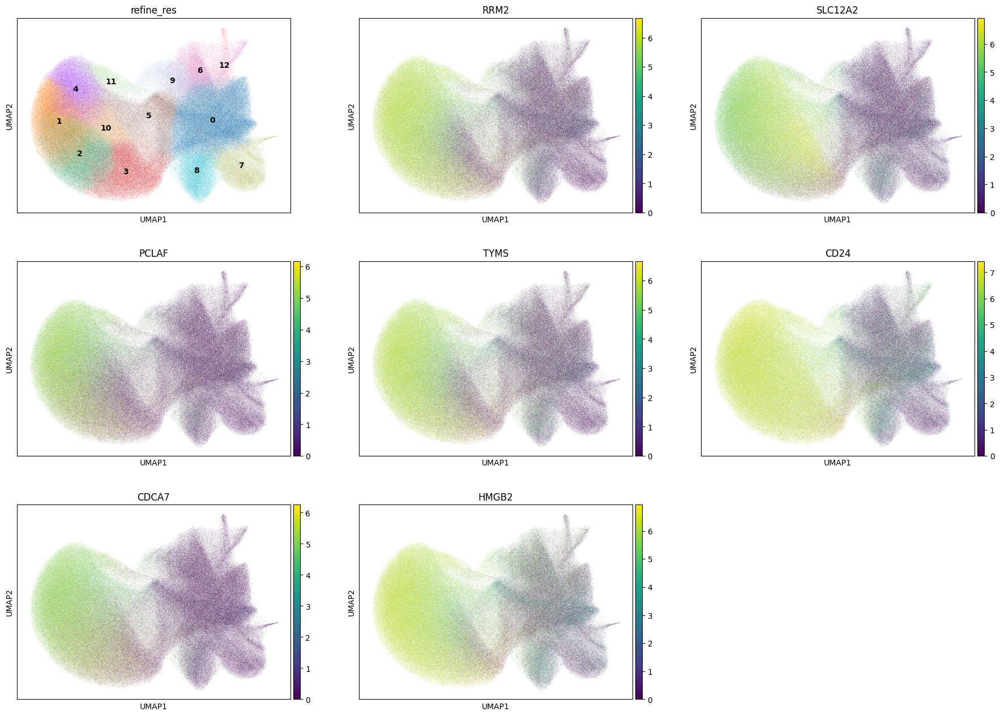

In [58]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [59]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 48731
Percentage of cells in cluster 4: 8.4


In [60]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Proliferating_colorectal_epithelial_cell'

### 5.6. Cluster 5

In [61]:
cluster_id = '5'

In [62]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Macrophage,Macrophage,normal_cell,47.0
1,Epithelial,Colorectal_epithelial_cell,normal_cell,21.0
2,Epithelial,High_proliferative_epithelial_cell,cancer_cell,15.4
3,NA,NA,NA,13.3
4,T,T,normal_cell,2.0


In [63]:
top_ranked_genes[cluster_id]

0        CTSB
1      RNASE1
2        APOE
3        CYBB
4    SERPINA1
5       MS4A7
6        CD14
Name: 5, dtype: object

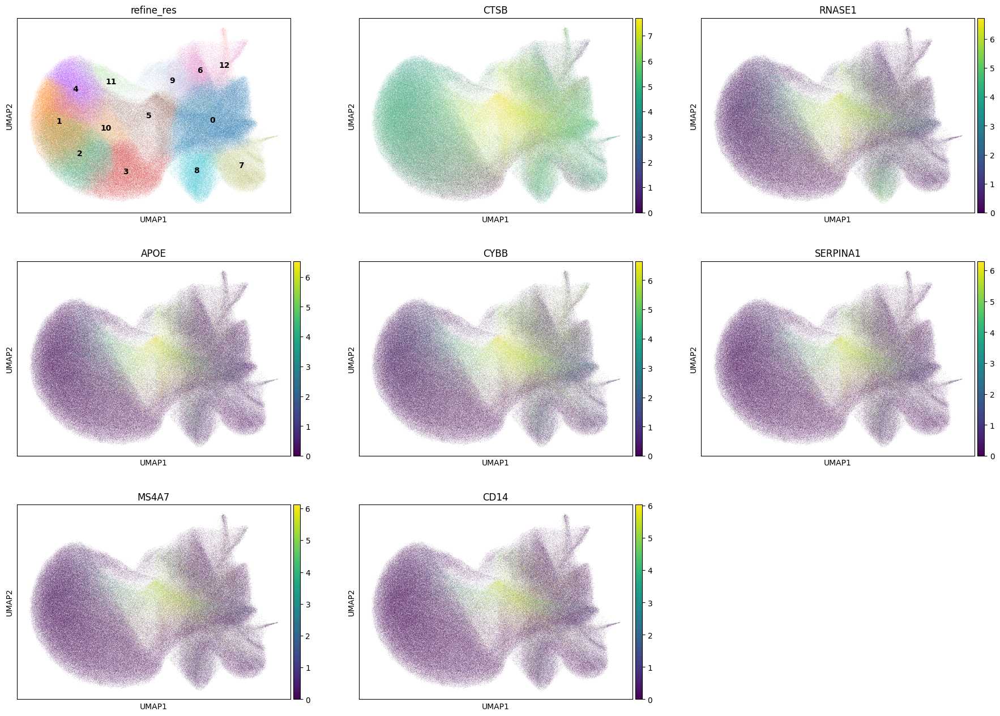

In [64]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [65]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 45266
Percentage of cells in cluster 5: 7.8


In [66]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Macrophage'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Macrophage'

### 5.7. Cluster 6

In [67]:
cluster_id = '6'

In [68]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T,T,normal_cell,59.6
1,B,B,normal_cell,28.4
2,NA,NA,NA,5.9
3,Macrophage,Macrophage,normal_cell,4.1
4,Fibroblast,CAF,normal_cell,0.8


In [69]:
top_ranked_genes[cluster_id]

0     CXCR4
1      TRAC
2     TRBC2
3      CD3E
4      ETS1
5       CD2
6    SPOCK2
Name: 6, dtype: object

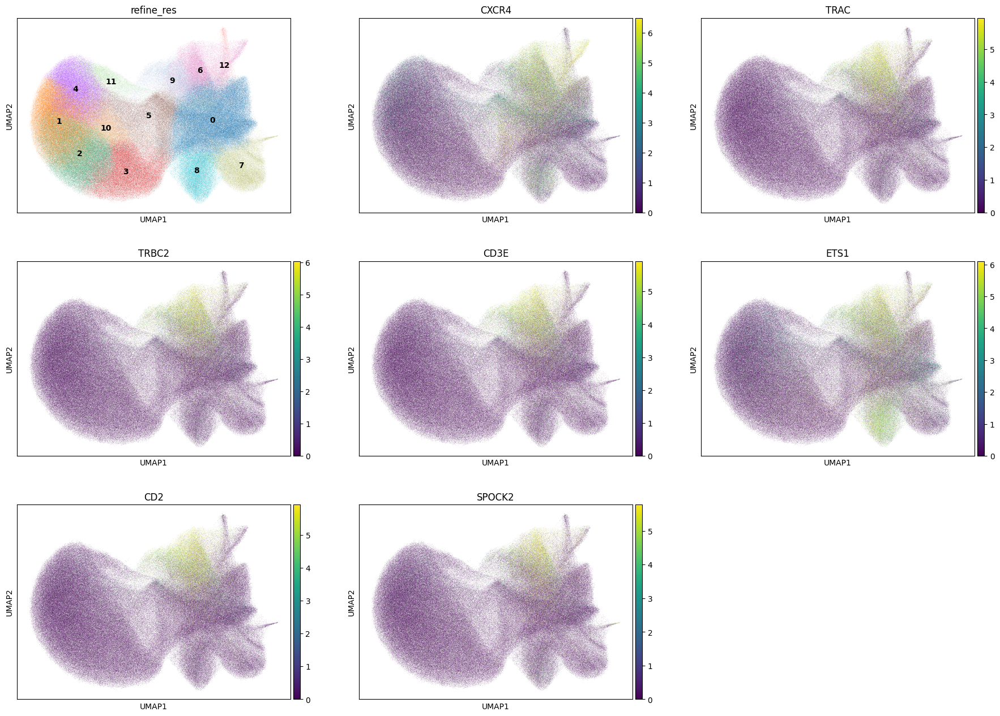

In [70]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [71]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 33869
Percentage of cells in cluster 6: 5.9


In [72]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T'

### 5.8. Cluster 7

In [73]:
cluster_id = '7'

In [74]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Myofibroblast,Myofibroblast,normal_cell,58.7
1,NA,NA,NA,19.7
2,Fibroblast,CAF,normal_cell,10.8
3,Macrophage,Macrophage,normal_cell,3.8
4,Pericyte,Pericyte,normal_cell,2.4


In [75]:
top_ranked_genes[cluster_id]

0     TAGLN
1     ACTA2
2     GREM1
3      RGS5
4       TNC
5      SOD3
6    DPYSL3
Name: 7, dtype: object

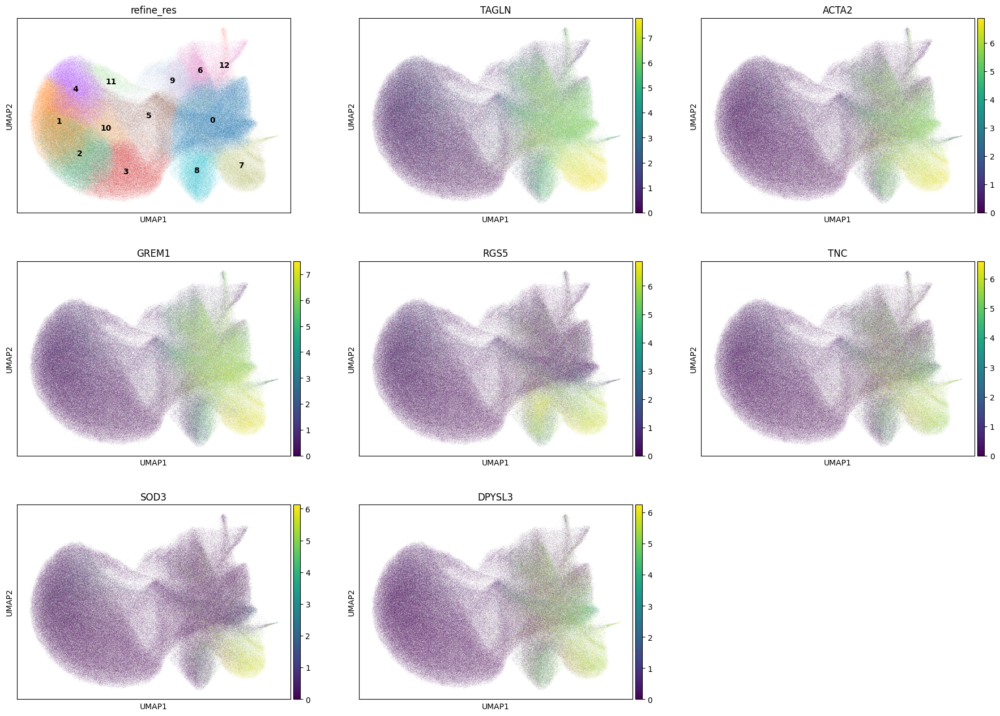

In [76]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [77]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 33214
Percentage of cells in cluster 7: 5.7


In [78]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Myofibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Myofibroblast'

### 5.9. Cluster 8

In [79]:
cluster_id = '8'

In [80]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Endothelial,Endothelial,normal_cell,51.4
1,Pericyte,Pericyte,normal_cell,26.3
2,NA,NA,NA,7.6
3,Fibroblast,CAF,normal_cell,4.3
4,Macrophage,Macrophage,normal_cell,3.8


In [81]:
top_ranked_genes[cluster_id]

0    IGFBP7
1     PLVAP
2    PECAM1
3       VWF
4      NID1
5      RGS5
6    PLXND1
Name: 8, dtype: object

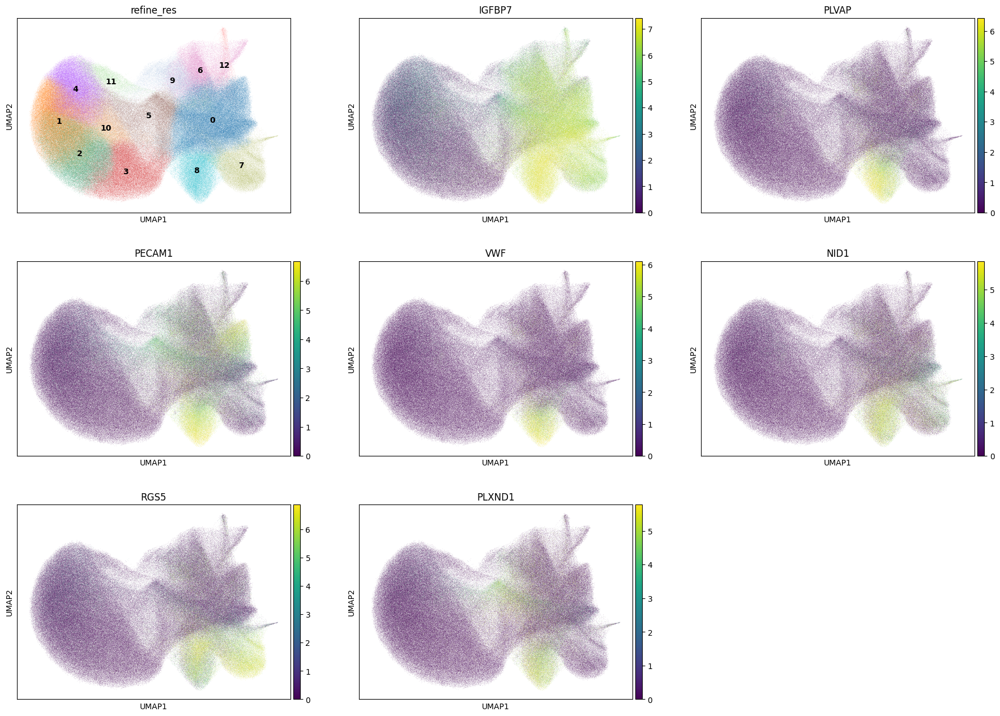

In [82]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [83]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 32580
Percentage of cells in cluster 8: 5.6


In [84]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Angiogenic_endothelial_cell'

### 5.10. Cluster 9

In [85]:
cluster_id = '9'

In [86]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T,T,normal_cell,84.1
1,NA,NA,NA,5.5
2,Macrophage,Macrophage,normal_cell,3.6
3,Epithelial,Colorectal_epithelial_cell,normal_cell,2.4
4,Epithelial,High_proliferative_epithelial_cell,cancer_cell,1.8


In [87]:
top_ranked_genes[cluster_id]

0    CCL5
1    GZMA
2    CD8A
3     CD2
4    CD3E
5    PRF1
6    NKG7
Name: 9, dtype: object

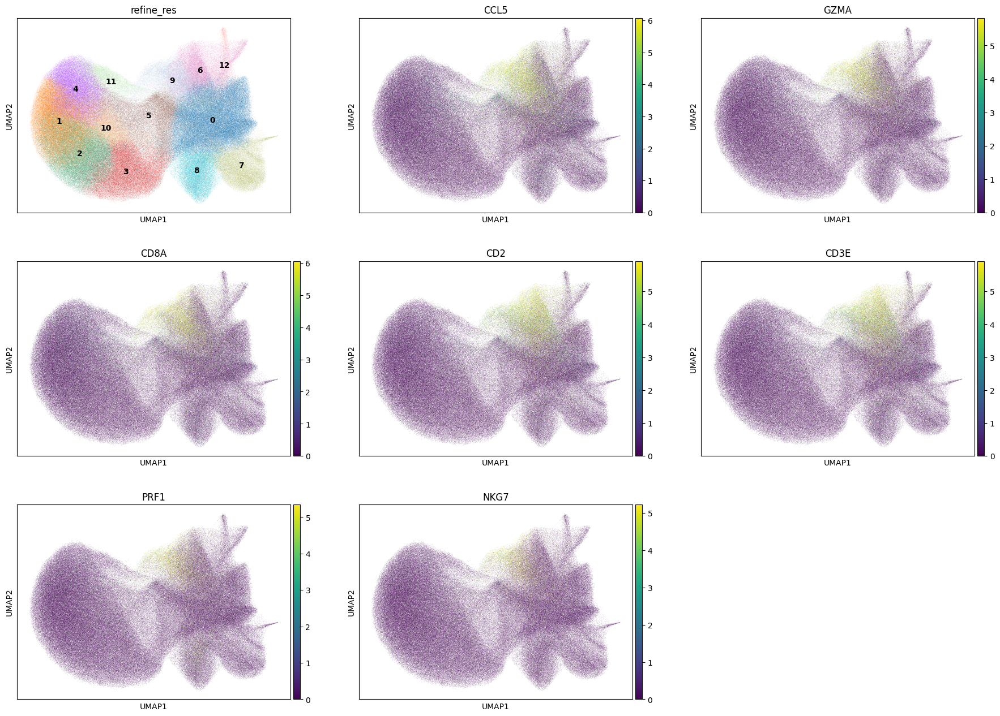

In [88]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [89]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 9: 21230
Percentage of cells in cluster 9: 3.7


In [90]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T_CD8'

### 5.11. Cluster 10

In [91]:
cluster_id = '10'

In [92]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Colorectal_epithelial_cell,normal_cell,74.8
1,Epithelial,High_proliferative_epithelial_cell,cancer_cell,24.8
2,NA,NA,NA,0.3
3,T,T,normal_cell,0.1
4,Macrophage,Macrophage,normal_cell,0.0


In [93]:
top_ranked_genes[cluster_id]

0    SLC12A2
1      EPCAM
2       SOX4
3    CEACAM5
4       PIGR
5       CD24
6       CDH1
Name: 10, dtype: object

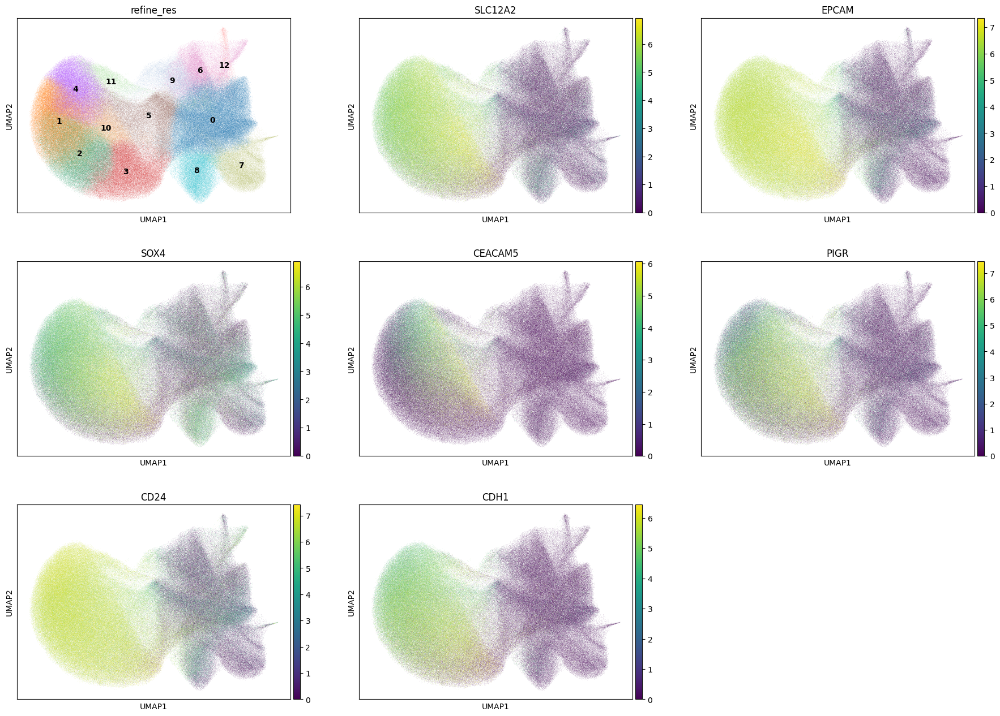

In [95]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [96]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 10: 20441
Percentage of cells in cluster 10: 3.5


In [97]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Colorectal_epithelial_cell'

### 5.12. Cluster 11

In [98]:
cluster_id = '11'

In [99]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Colorectal_epithelial_cell,normal_cell,58.4
1,Epithelial,High_proliferative_epithelial_cell,cancer_cell,20.0
2,NA,NA,NA,11.2
3,T,T,normal_cell,4.0
4,Macrophage,Macrophage,normal_cell,3.9


In [100]:
top_ranked_genes[cluster_id]

0       CD24
1      EPCAM
2       KRT8
3      HMGB2
4    SLC12A2
5       TYMS
6       RRM2
Name: 11, dtype: object

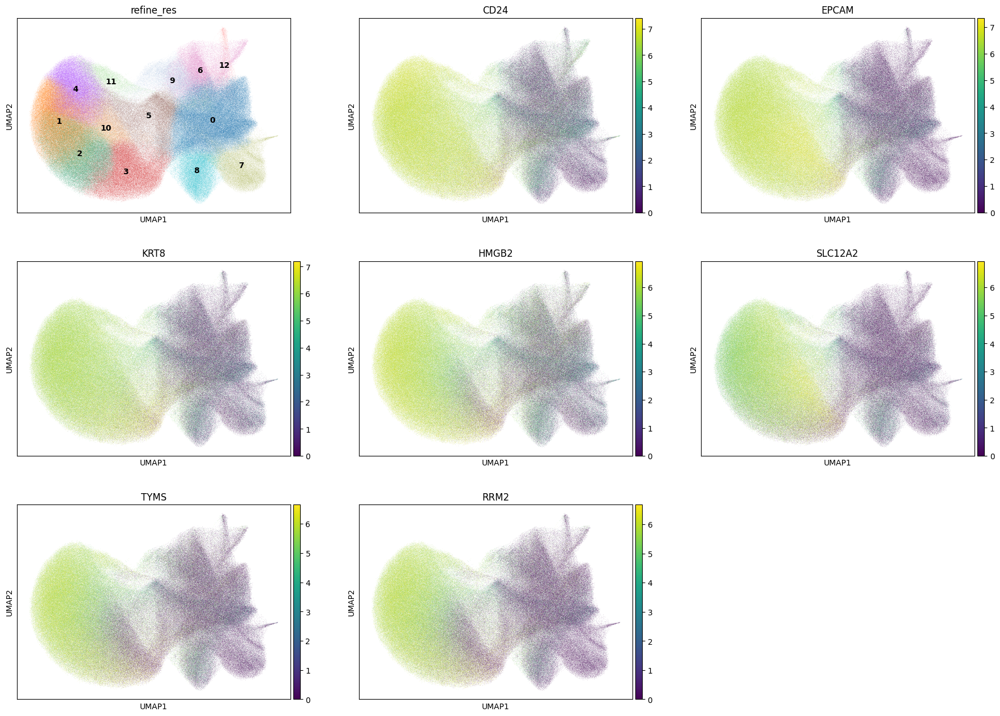

In [102]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [103]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 11: 12794
Percentage of cells in cluster 11: 2.2


In [104]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Proliferating_colorectal_epithelial_cell'

### 5.13. Cluster 12

In [105]:
cluster_id = '12'

In [106]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Mast,Mast,normal_cell,45.8
1,NA,NA,NA,15.3
2,T,T,normal_cell,10.8
3,B,B,normal_cell,10.5
4,Fibroblast,CAF,normal_cell,7.5


In [107]:
top_ranked_genes[cluster_id]

0       CPA3
1      MS4A2
2     IL1RL1
3        KIT
4     COL1A1
5      THBS1
6    SLC18A2
Name: 12, dtype: object

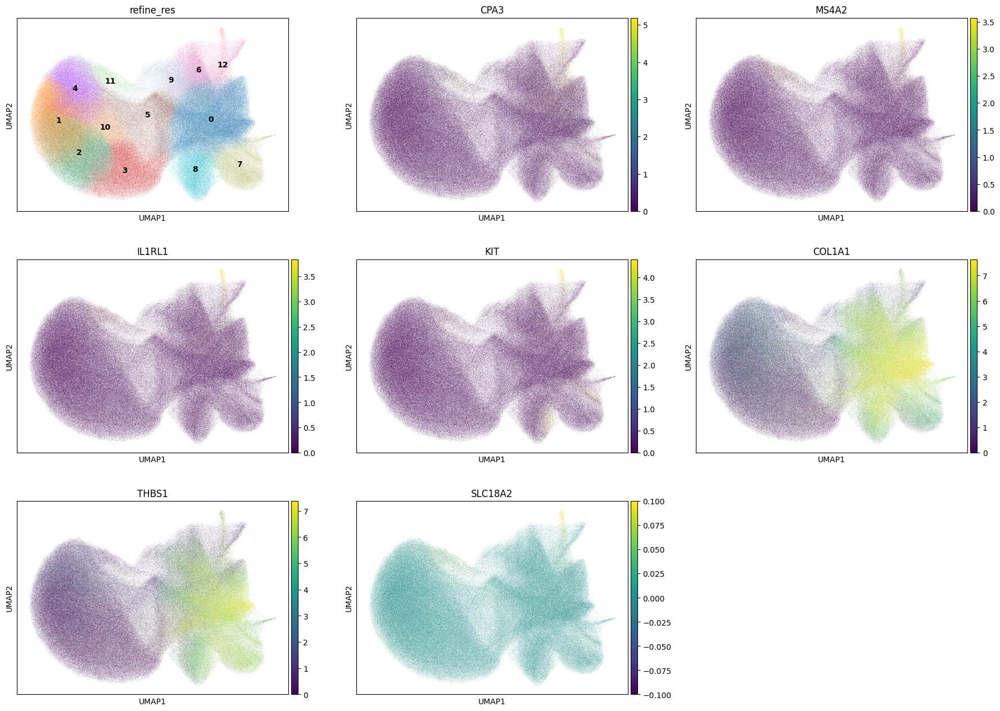

In [109]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [110]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 12: 4011
Percentage of cells in cluster 12: 0.7


In [111]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Mast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Mast'

## 6. Cancer cells

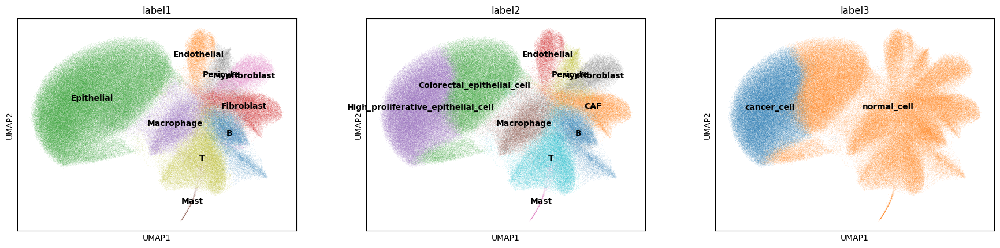

In [114]:
sc.pl.umap(adata_nuclei, color=['label1', 'label2', 'label3'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

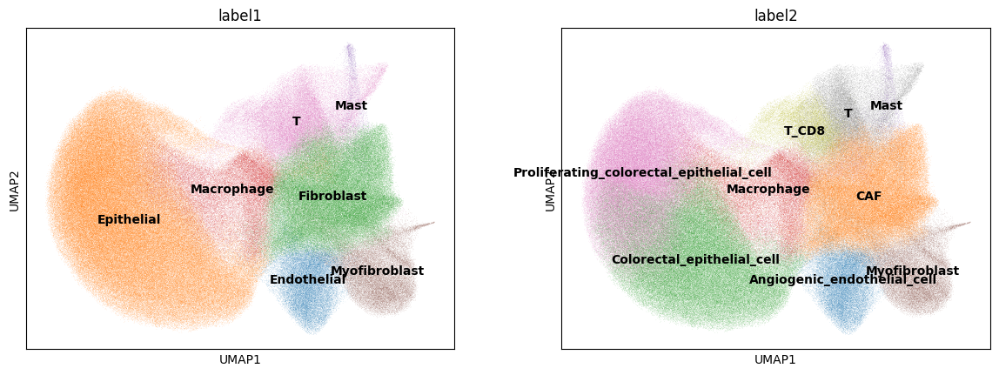

In [115]:
sc.pl.umap(adata_cells, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [116]:
# Cancer cells
adata_cells.obs['label3'] = 'normal_cell'
adata_cells.obs.loc[adata_cells.obs['label1'].isin(['Epithelial']), 'label3'] = 'cancer_cell'

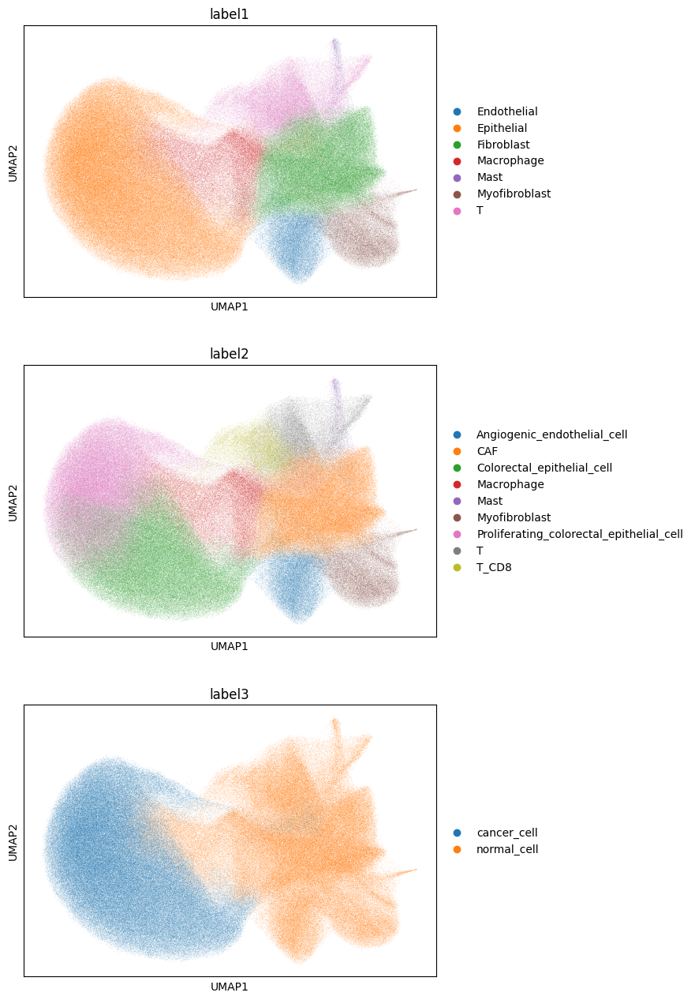

In [117]:
sc.pl.umap(adata_cells, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [118]:
adata_cells.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
0,aaaaaaaa-1,25,0,0,0,0,25,33.054376,11.966407,cell_labels,0,4,9,9,T,T_CD8,normal_cell
1,aaaaaaab-1,60,0,0,0,0,60,92.976722,20.907345,cell_labels,0,1,0,0,Fibroblast,CAF,normal_cell
2,aaaaaaac-1,17,0,0,0,0,17,178.186569,7.766875,cell_labels,0,1,0,0,Fibroblast,CAF,normal_cell
3,aaaaaaad-1,33,0,0,0,0,33,84.984066,16.888438,cell_labels,0,5,8,8,Endothelial,Angiogenic_endothelial_cell,normal_cell
4,aaaaaaae-1,18,0,0,0,0,18,43.485470,18.378594,cell_labels,0,1,0,0,Fibroblast,CAF,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
587110,aaaipfgg-1,209,0,0,0,0,209,78.120315,64.979846,cell_labels,1,0,1,1,Epithelial,Proliferating_colorectal_epithelial_cell,cancer_cell
587111,aaaipfgh-1,109,0,0,0,0,109,56.625940,38.563439,cell_labels,1,0,1,1,Epithelial,Proliferating_colorectal_epithelial_cell,cancer_cell
587112,aaaipfgi-1,127,0,0,0,0,127,53.239221,30.074064,cell_labels,1,0,1,1,Epithelial,Proliferating_colorectal_epithelial_cell,cancer_cell
587113,aaaipfgj-1,298,0,0,0,0,298,105.710785,74.417503,cell_labels,1,0,1,1,Epithelial,Proliferating_colorectal_epithelial_cell,cancer_cell


In [119]:
adata_cells.write_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")
# adata_cells = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")